In [10]:
from pathlib import Path
BASE = Path('.').resolve().parent
ABS_BASE = BASE / 'notebooks'
RAW_DIR = BASE / 'dataset' / 'raw'
SRC_DIR = BASE / 'dataset' / 'source_images'
DATASET_DIR = BASE / 'dataset'
RESULTS_DIR = BASE / 'results'
for p in [RAW_DIR, SRC_DIR, DATASET_DIR, RESULTS_DIR]:
    p.mkdir(parents=True, exist_ok=True)
print('Dirs ok:')
print('RAW_DIR:', RAW_DIR)
print('SRC_DIR:', SRC_DIR)
print('DATASET_DIR:', DATASET_DIR)
print('RESULTS_DIR:', RESULTS_DIR)

Dirs ok:
RAW_DIR: C:\Projetos\Estudos\FIAP\Cap 1 - Despertar da rede neural\dataset\raw
SRC_DIR: C:\Projetos\Estudos\FIAP\Cap 1 - Despertar da rede neural\dataset\source_images
DATASET_DIR: C:\Projetos\Estudos\FIAP\Cap 1 - Despertar da rede neural\dataset
RESULTS_DIR: C:\Projetos\Estudos\FIAP\Cap 1 - Despertar da rede neural\results


In [8]:
import zipfile, shutil
from pathlib import Path
from PIL import Image
import random

MAX_IMAGES = 40
ZIP_MAP = {'vaca':'cows.zip', 'cerca':'fences.zip'}

def is_valid_image(p:Path):
    try:
        with Image.open(p) as im:
            im.verify()
        return True
    except Exception:
        return False

for cls, zipname in ZIP_MAP.items():
    zip_path = RAW_DIR / zipname
    outdir = SRC_DIR / cls
    if outdir.exists():
        shutil.rmtree(outdir)
    outdir.mkdir(parents=True, exist_ok=True)
    if not zip_path.exists():
        print(f'[WARN] zip {zip_path} not found — pulei {cls}')
        continue
    tmp = DATASET_DIR / f'_tmp_{cls}'
    if tmp.exists():
        shutil.rmtree(tmp)
    tmp.mkdir(parents=True, exist_ok=True)
    print(f'Extraindo {zip_path} -> {tmp}')
    with zipfile.ZipFile(zip_path, 'r') as z:
        z.extractall(tmp)
    imgs = [p for p in tmp.rglob('*') if p.suffix.lower() in ('.jpg','.jpeg','.png','.webp')]
    print(f'Encontradas {len(imgs)} imagens brutas em {zipname}')
    valid = [p for p in imgs if is_valid_image(p)]
    print(f'Válidas: {len(valid)}')
    valid = valid[:MAX_IMAGES]
    for i,p in enumerate(valid, start=1):
        dest = outdir / f"{cls}_{i:03d}{p.suffix.lower()}"
        shutil.copy(p, dest)
    print(f'Copiados {len(valid)} para {outdir}')
    shutil.rmtree(tmp)

print('Conteúdo em dataset/source_images:')
for cls in ZIP_MAP.keys():
    p = SRC_DIR/cls
    print(cls, len(list(p.glob('*'))))


Extraindo C:\Projetos\Estudos\FIAP\Cap 1 - Despertar da rede neural\dataset\raw\cows.zip -> C:\Projetos\Estudos\FIAP\Cap 1 - Despertar da rede neural\dataset\_tmp_vaca
Encontradas 102 imagens brutas em cows.zip
Encontradas 102 imagens brutas em cows.zip
Válidas: 102
Válidas: 102
Copiados 40 para C:\Projetos\Estudos\FIAP\Cap 1 - Despertar da rede neural\dataset\source_images\vaca
Extraindo C:\Projetos\Estudos\FIAP\Cap 1 - Despertar da rede neural\dataset\raw\fences.zip -> C:\Projetos\Estudos\FIAP\Cap 1 - Despertar da rede neural\dataset\_tmp_cerca
Copiados 40 para C:\Projetos\Estudos\FIAP\Cap 1 - Despertar da rede neural\dataset\source_images\vaca
Extraindo C:\Projetos\Estudos\FIAP\Cap 1 - Despertar da rede neural\dataset\raw\fences.zip -> C:\Projetos\Estudos\FIAP\Cap 1 - Despertar da rede neural\dataset\_tmp_cerca
Encontradas 1200 imagens brutas em fences.zip
Encontradas 1200 imagens brutas em fences.zip
Válidas: 1200
Copiados 40 para C:\Projetos\Estudos\FIAP\Cap 1 - Despertar da rede 

In [9]:
import random
from pathlib import Path
import shutil

SPLIT_COUNTS = {'train':32,'val':4,'test':4}
SEED=42
random.seed(SEED)

for split in SPLIT_COUNTS.keys():
    for cls in ZIP_MAP.keys():
        (DATASET_DIR / split / f'class_{cls}').mkdir(parents=True, exist_ok=True)

summary = {}
for cls in ZIP_MAP.keys():
    src_files = sorted(list((SRC_DIR/cls).glob('*.*')))
    print(f'{cls}: total available =', len(src_files))
    random.shuffle(src_files)
    idx=0
    for split, n in SPLIT_COUNTS.items():
        selection = src_files[idx:idx+n]
        idx += n
        dst = DATASET_DIR / split / f'class_{cls}'
        for p in selection:
            shutil.copy(p, dst / p.name)
        print(f'  {split}: {len(selection)}')
    summary[cls]=len(src_files)

yaml_text = f"train: {str((DATASET_DIR/'train').as_posix())}\nval: {str((DATASET_DIR/'val').as_posix())}\ntest: {str((DATASET_DIR/'test').as_posix())}\n\nnc: {len(ZIP_MAP)}\nnames: {list(ZIP_MAP.keys())}\n"
(DATASET_DIR / 'data.yaml').write_text(yaml_text)
print('\nWrote dataset/data.yaml')
print((DATASET_DIR / 'data.yaml').read_text())


vaca: total available = 40
  train: 32
  val: 4
  train: 32
  val: 4
  test: 4
cerca: total available = 40
  test: 4
cerca: total available = 40
  train: 32
  val: 4
  test: 4

Wrote dataset/data.yaml
train: C:/Projetos/Estudos/FIAP/Cap 1 - Despertar da rede neural/dataset/train
val: C:/Projetos/Estudos/FIAP/Cap 1 - Despertar da rede neural/dataset/val
test: C:/Projetos/Estudos/FIAP/Cap 1 - Despertar da rede neural/dataset/test

nc: 2
names: ['vaca', 'cerca']

  train: 32
  val: 4
  test: 4

Wrote dataset/data.yaml
train: C:/Projetos/Estudos/FIAP/Cap 1 - Despertar da rede neural/dataset/train
val: C:/Projetos/Estudos/FIAP/Cap 1 - Despertar da rede neural/dataset/val
test: C:/Projetos/Estudos/FIAP/Cap 1 - Despertar da rede neural/dataset/test

nc: 2
names: ['vaca', 'cerca']



In [12]:
import time
import torch
import torch.nn as nn
import torch.optim as optim
from torchvision import transforms, datasets
from torch.utils.data import DataLoader
import pandas as pd
import numpy as np
import random
from pathlib import Path

SEED=42
random.seed(SEED); np.random.seed(SEED); torch.manual_seed(SEED)
if torch.cuda.is_available():
    torch.cuda.manual_seed_all(SEED)

IMG_SIZE=224; BATCH=8; EPOCHS=5
RESULTS_DIR.mkdir(parents=True, exist_ok=True)

train_tf = transforms.Compose([transforms.Resize((IMG_SIZE,IMG_SIZE)), transforms.RandomHorizontalFlip(), transforms.ToTensor(), transforms.Normalize([0.485,0.456,0.406],[0.229,0.224,0.225])])
val_tf = transforms.Compose([transforms.Resize((IMG_SIZE,IMG_SIZE)), transforms.ToTensor(), transforms.Normalize([0.485,0.456,0.406],[0.229,0.224,0.225])])

train_ds = datasets.ImageFolder(DATASET_DIR/'train', transform=train_tf)
val_ds = datasets.ImageFolder(DATASET_DIR/'val', transform=val_tf)
test_ds = datasets.ImageFolder(DATASET_DIR/'test', transform=val_tf)

train_loader = DataLoader(train_ds, batch_size=BATCH, shuffle=True)
val_loader = DataLoader(val_ds, batch_size=BATCH, shuffle=False)

class SimpleCNN(nn.Module):
    def __init__(self, n_classes=2):
        super().__init__()
        self.features = nn.Sequential(
            nn.Conv2d(3,32,3,padding=1), nn.BatchNorm2d(32), nn.ReLU(), nn.MaxPool2d(2),
            nn.Conv2d(32,64,3,padding=1), nn.BatchNorm2d(64), nn.ReLU(), nn.MaxPool2d(2),
            nn.Conv2d(64,128,3,padding=1), nn.BatchNorm2d(128), nn.ReLU(), nn.MaxPool2d(2),
            nn.AdaptiveAvgPool2d((4,4))
        )
        self.classifier = nn.Sequential(nn.Flatten(), nn.Linear(128*4*4,512), nn.ReLU(), nn.Dropout(0.5), nn.Linear(512,n_classes))
    def forward(self,x):
        x = self.features(x); x = self.classifier(x); return x

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model = SimpleCNN(n_classes=len(train_ds.classes)).to(device)
criterion = nn.CrossEntropyLoss(); optimizer = optim.Adam(model.parameters(), lr=1e-4)

history = []
for ep in range(1, EPOCHS+1):
    t0 = time.time(); model.train(); train_loss=0; correct=0; total=0
    for imgs, labels in train_loader:
        imgs, labels = imgs.to(device), labels.to(device)
        optimizer.zero_grad(); out = model(imgs); loss = criterion(out, labels); loss.backward(); optimizer.step()
        train_loss += loss.item()*imgs.size(0)
        _, preds = out.max(1); correct += (preds==labels).sum().item(); total += labels.size(0)
    train_loss = train_loss/total if total else 0; train_acc = correct/total if total else 0

    model.eval(); v_loss=0; v_corr=0; v_tot=0
    with torch.no_grad():
        for imgs, labels in val_loader:
            imgs, labels = imgs.to(device), labels.to(device)
            out = model(imgs); loss = criterion(out, labels)
            v_loss += loss.item()*imgs.size(0)
            _, preds = out.max(1); v_corr += (preds==labels).sum().item(); v_tot += labels.size(0)
    val_loss = v_loss/v_tot if v_tot else 0; val_acc = v_corr/v_tot if v_tot else 0
    elapsed = time.time()-t0
    history.append((ep, train_loss, val_loss, train_acc, val_acc, elapsed))
    print(f"Epoch {ep}/{EPOCHS} - tr_loss {train_loss:.4f} val_loss {val_loss:.4f} tr_acc {train_acc:.4f} val_acc {val_acc:.4f} time {elapsed:.1f}s")
    torch.save({'epoch':ep,'model_state':model.state_dict()}, RESULTS_DIR/f'cnn_ckpt_ep{ep}.pth')

import pandas as pd
df = pd.DataFrame(history, columns=['epoch','train_loss','val_loss','train_acc','val_acc','epoch_time_s'])
df.to_csv(RESULTS_DIR/'cnn_metrics.csv', index=False)
print('CNN training complete; results in', RESULTS_DIR)


Epoch 1/5 - tr_loss 0.4713 val_loss 0.5552 tr_acc 0.6094 val_acc 1.0000 time 23.1s
Epoch 2/5 - tr_loss 0.1354 val_loss 0.2952 tr_acc 1.0000 val_acc 1.0000 time 21.0s
Epoch 3/5 - tr_loss 0.0605 val_loss 0.0605 tr_acc 1.0000 val_acc 1.0000 time 21.7s
Epoch 4/5 - tr_loss 0.0292 val_loss 0.0123 tr_acc 1.0000 val_acc 1.0000 time 21.0s
Epoch 5/5 - tr_loss 0.0075 val_loss 0.0043 tr_acc 1.0000 val_acc 1.0000 time 21.5s
CNN training complete; results in C:\Projetos\Estudos\FIAP\Cap 1 - Despertar da rede neural\results


In [14]:
from ultralytics import YOLO


DATA_YAML = str((DATASET_DIR/'data.yaml').as_posix())
print('Using data.yaml:', DATA_YAML)

epochs1 = 10
epochs2 = 20
imgsz = 640
batch = 8
weights = 'yolov8n.pt'

model = YOLO(weights)
print('Starting YOLO training 1 (epochs=', epochs1, ')')
model.train(data=DATA_YAML, epochs=epochs1, imgsz=imgsz, batch=batch, project=str(RESULTS_DIR/'yolo'), name=f'yolo_exp_{epochs1}')
print('Finished training 1')

model = YOLO(weights)
print('Starting YOLO training 2 (epochs=', epochs2, ')')
model.train(data=DATA_YAML, epochs=epochs2, imgsz=imgsz, batch=batch, project=str(RESULTS_DIR/'yolo'), name=f'yolo_exp_{epochs2}')
print('Finished training 2')


Using data.yaml: C:/Projetos/Estudos/FIAP/Cap 1 - Despertar da rede neural/dataset/data.yaml
Starting YOLO training 1 (epochs= 10 )


New https://pypi.org/project/ultralytics/8.3.211 available  Update with 'pip install -U ultralytics'
Ultralytics YOLOv8.0.171  Python-3.11.9 torch-2.2.0+cpu CPU (Intel Core(TM) i7-10750H 2.60GHz)
engine\trainer: task=detect, mode=train, model=yolov8n.pt, data=C:/Projetos/Estudos/FIAP/Cap 1 - Despertar da rede neural/dataset/data.yaml, epochs=10, patience=50, batch=8, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=C:\Projetos\Estudos\FIAP\Cap 1 - Despertar da rede neural\results\yolo, name=yolo_exp_10, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, show=False, save_txt=False, save_conf=False, save_crop=

zero-size array to reduction operation maximum which has no identity


Image sizes 640 train, 640 val
Using 0 dataloader workers
Logging results to C:\Projetos\Estudos\FIAP\Cap 1 - Despertar da rede neural\results\yolo\yolo_exp_10
Starting training for 10 epochs...
Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
       1/10         0G          0      62.68          0          0        640: 100%|██████████| 8/8 [01:00<00:00,  7.55s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:02<00:00,  2.70s/it]
                   all          8          0          0          0          0          0
WARNING  no labels found in detect set, can not compute metrics without labels

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
       2/10         0G        

Finished training 1
Starting YOLO training 2 (epochs= 20 )


New https://pypi.org/project/ultralytics/8.3.211 available  Update with 'pip install -U ultralytics'
Ultralytics YOLOv8.0.171  Python-3.11.9 torch-2.2.0+cpu CPU (Intel Core(TM) i7-10750H 2.60GHz)
engine\trainer: task=detect, mode=train, model=yolov8n.pt, data=C:/Projetos/Estudos/FIAP/Cap 1 - Despertar da rede neural/dataset/data.yaml, epochs=20, patience=50, batch=8, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=C:\Projetos\Estudos\FIAP\Cap 1 - Despertar da rede neural\results\yolo, name=yolo_exp_20, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, show=False, save_txt=False, save_conf=False, save_crop=

zero-size array to reduction operation maximum which has no identity


Image sizes 640 train, 640 val
Using 0 dataloader workers
Logging results to C:\Projetos\Estudos\FIAP\Cap 1 - Despertar da rede neural\results\yolo\yolo_exp_20
Starting training for 20 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
       1/20         0G          0      62.74          0          0        640: 100%|██████████| 8/8 [00:58<00:00,  7.31s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:02<00:00,  2.78s/it]
                   all          8          0          0          0          0          0
WARNING  no labels found in detect set, can not compute metrics without labels

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
       2/20         0G          0      60.75          0          0        640: 100%|██████████| 8/8 [00:42<00:00,  5.28s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100

Finished training 2


In [9]:
from pathlib import Path
from ultralytics import YOLO

res_yolo = RESULTS_DIR / 'yolo'


runs = sorted([d for d in res_yolo.iterdir() if d.is_dir()])
print('Runs:', [r.name for r in runs])
latest = runs[-1]
weights_dir = latest / 'weights'
best = None
if weights_dir.exists():
    w = sorted(weights_dir.glob('*.pt'))
    if w:
        best = str(w[-1])
if best:
    print('Using weight', best)
    y = YOLO(best)
    out_cerca = y.predict(source=DATASET_DIR / 'test/class_cerca', save=True, project='results', name='yolo_preds')
    out_vaca = y.predict(source=DATASET_DIR / 'test/class_vaca', save=True, project='results', name='yolo_preds')

    print('Predictions saved under results/yolo_preds')


Runs: ['yolo_exp_10', 'yolo_exp_20', 'yolo_exp_30', 'yolo_exp_302', 'yolo_exp_60']
Using weight C:\Projetos\Estudos\FIAP\Cap 1 - Despertar da rede neural\results\yolo\yolo_exp_60\weights\last.pt



image 1/4 C:\Projetos\Estudos\FIAP\Cap 1 - Despertar da rede neural\dataset\test\class_cerca\cerca_003.png: 448x640 (no detections), 127.9ms
image 2/4 C:\Projetos\Estudos\FIAP\Cap 1 - Despertar da rede neural\dataset\test\class_cerca\cerca_017.png: 448x640 (no detections), 138.8ms
image 3/4 C:\Projetos\Estudos\FIAP\Cap 1 - Despertar da rede neural\dataset\test\class_cerca\cerca_023.png: 448x640 (no detections), 125.3ms
image 4/4 C:\Projetos\Estudos\FIAP\Cap 1 - Despertar da rede neural\dataset\test\class_cerca\cerca_040.png: 448x640 (no detections), 129.5ms
Speed: 7.2ms preprocess, 130.4ms inference, 0.9ms postprocess per image at shape (1, 3, 448, 640)
Results saved to results\yolo_preds

image 1/4 C:\Projetos\Estudos\FIAP\Cap 1 - Despertar da rede neural\dataset\test\class_vaca\vaca_002.png: 480x640 (no detections), 122.0ms
image 2/4 C:\Projetos\Estudos\FIAP\Cap 1 - Despertar da rede neural\dataset\test\class_vaca\vaca_008.png: 480x640 (no detections), 123.3ms
image 3/4 C:\Projetos\

Predictions saved under results/yolo_preds


Mostrando predições de: C:\Projetos\Estudos\FIAP\Cap 1 - Despertar da rede neural\notebooks\results\yolo_preds2


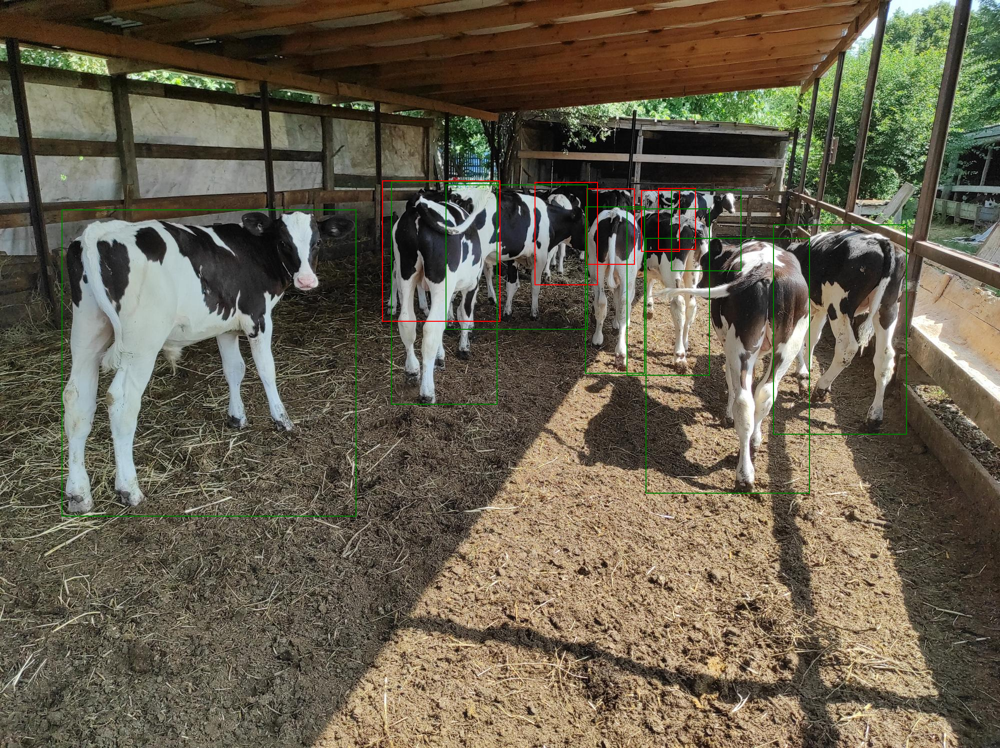

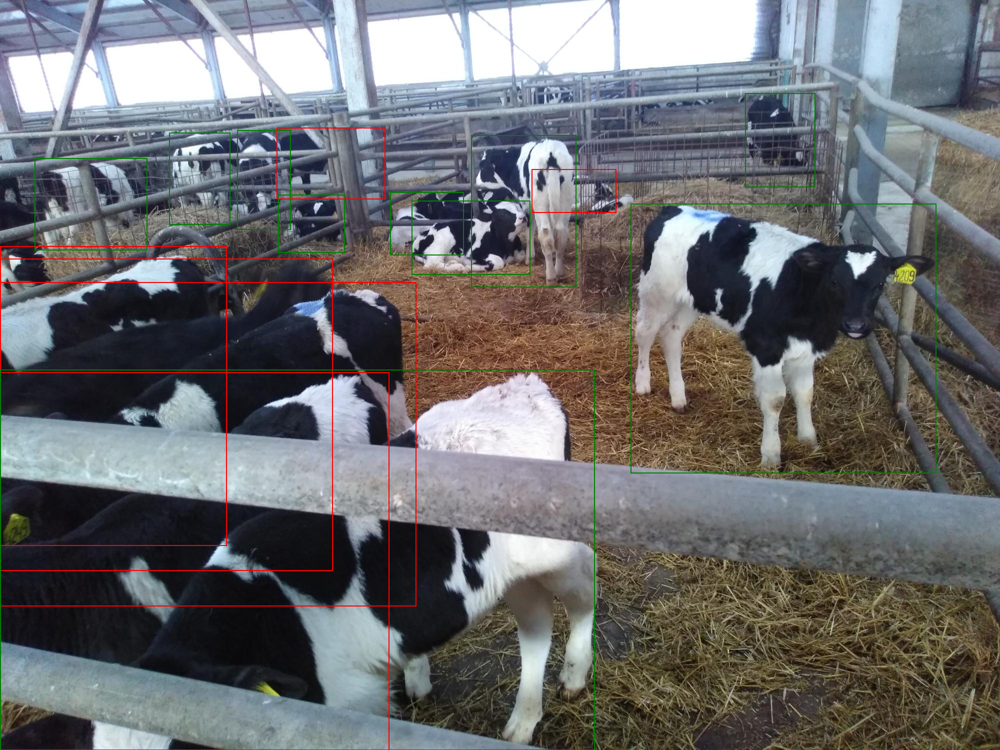

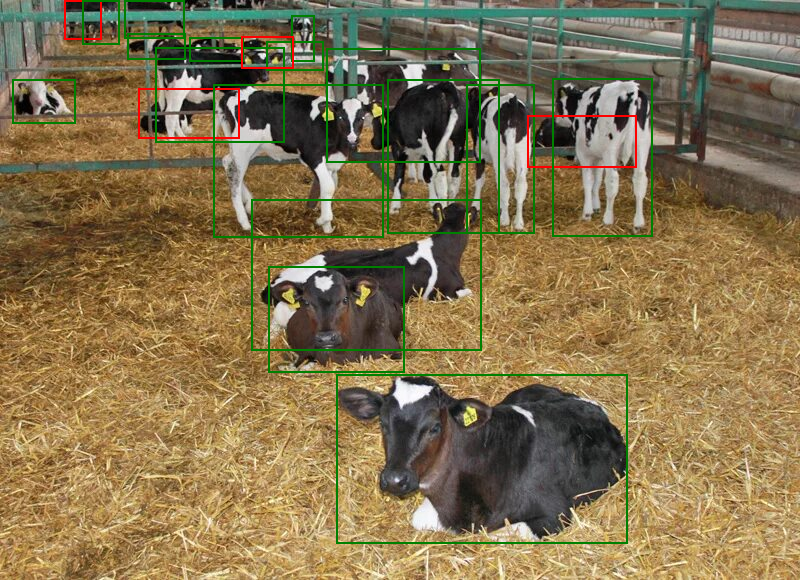

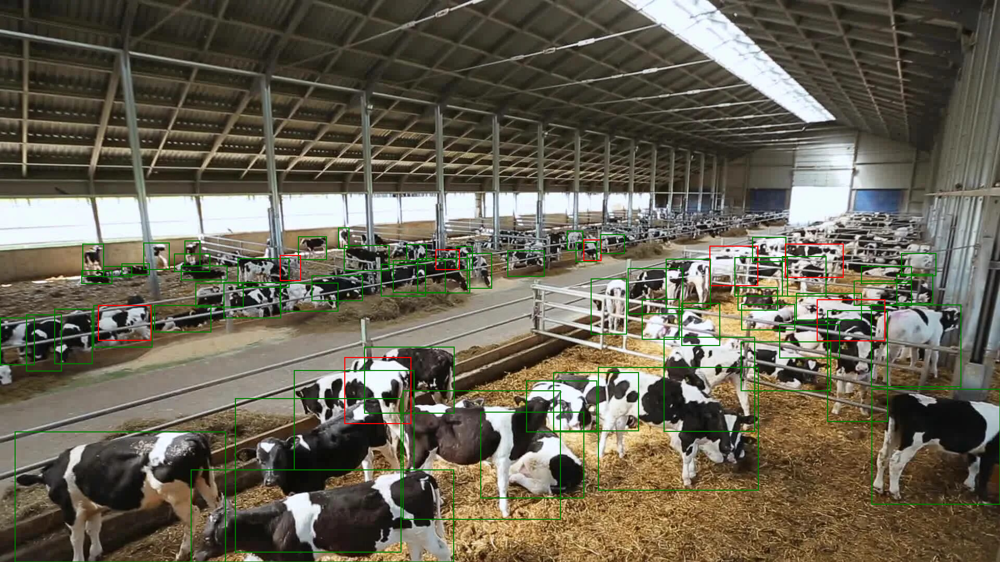

In [15]:
from IPython.display import Image, display
from pathlib import Path
pred_dir = ABS_BASE / 'results' / 'yolo_preds2'
print('Mostrando predições de:', pred_dir)
if pred_dir.exists():
    imgs = list(pred_dir.glob('**/*.*'))
    for im in imgs[:6]:
        display(Image(str(im)))
else:
    print('Nenhuma predição encontrada. Execute treino/inferência primeiro.')
